In [1]:
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import scanpy.external as sce

In [2]:
import session_info
session_info.show()

/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/session_info/main.py:213: UserWarning: The '__version__' attribute is deprecated and will be removed in MarkupSafe 3.1. Use feature detection, or `importlib.metadata.version("markupsafe")`, instead.
  mod_version = _find_version(mod.__version__)


In [3]:
sc.settings.set_figure_params(dpi=80)

# Read in adata

In [4]:
objects_dir = '/home/kk837/rds/rds-teichlab-C9woKbOCf2Y/kk837/Foetal/anndata_objects/Xenium'
path_adata = f'{objects_dir}/C194-HEA-0-FFPE-1_Hst45-HEA-0-FFPE-1_concat_5K_filtered_raw.h5ad'
adata = sc.read_h5ad(path_adata)
adata

AnnData object with n_obs × n_vars = 362277 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'n_genes', 'tissue_block_id', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'pca_harmony_leiden_0.2', 'pca_harmony_leiden_0.3', 'pca_harmony_leiden_0.4', 'pca_harmony_leiden_0.5', 'pca_harmony_leiden_0.8', 'pca_harmony_leiden_1.0', 'pca_harmony_leiden_1.5', 'pca_harmony_leiden_2.0', 'pca_harmony_leiden_

In [5]:
os.getcwd()

'/rfs/project/rfs-iCNyzSAaucw/kk837/notebooks/Foetal/Xenium/5K/C194_Hst45/CamU'

In [6]:
adata.X.data[:5]

array([5., 1., 1., 2., 2.], dtype=float32)

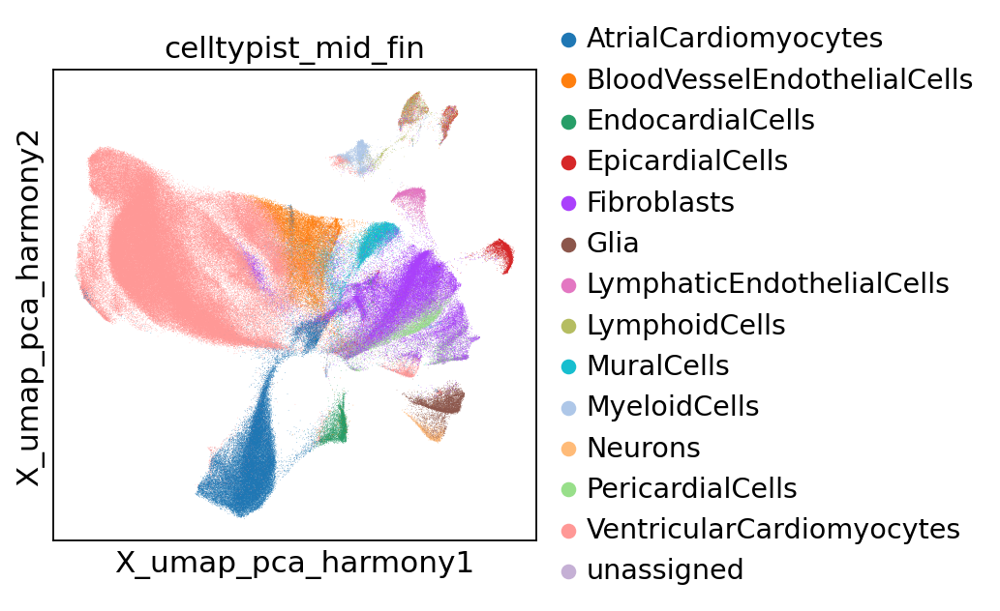

In [7]:
latent_space = 'pca_harmony'
sc.pl.embedding(adata,
                    basis=f"X_umap_{latent_space}",
                    color='celltypist_mid_fin',
                   )

In [8]:
adata.obs['celltypist_mid_fin'].value_counts()

celltypist_mid_fin
VentricularCardiomyocytes      188122
Fibroblasts                     49242
AtrialCardiomyocytes            47076
BloodVesselEndothelialCells     20055
MuralCells                      10986
PericardialCells                 8698
unassigned                       7967
Glia                             6976
EpicardialCells                  5206
EndocardialCells                 5202
MyeloidCells                     3965
LymphaticEndothelialCells        3674
LymphoidCells                    3116
Neurons                          1992
Name: count, dtype: int64

# Log-normalisation

In [9]:
# log-normalise the count
sc.pp.normalize_total(adata,target_sum=1e4)
sc.pp.log1p(adata)
adata.X.data[:5]

array([4.2093534, 2.6576407, 2.6576407, 3.3151019, 3.3151019],
      dtype=float32)

# Save UMAP and leiden clustering results

In [10]:
adata_dir = '/home/kk837/rds/rds-teichlab-C9woKbOCf2Y/kk837/Foetal/anndata_objects/Xenium/subsets'

In [ ]:
# adata.uns['log1p']['base'] = None

##### Fibroblasts #####


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number


(49242, 4999)
number of hvgs: 819


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:19:58,064 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:20:03,894 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:20:04,127 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:20:14,361 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:20:24,483 - harmonypy - INFO - Converged after 2 iterations
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm

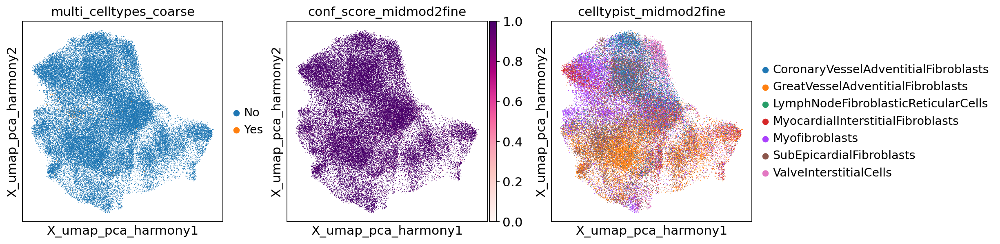

<timed exec>:30: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.


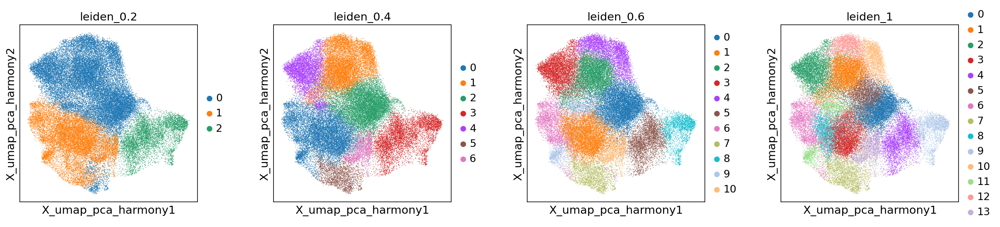

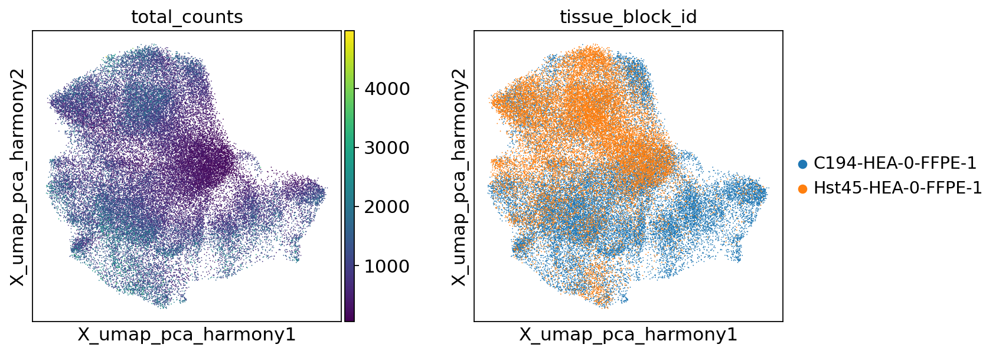


##### PericardialCells #####
(8698, 4737)
number of hvgs: 1209


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:22:08,885 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:22:10,837 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:22:10,858 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:22:11,811 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:22:12,765 - harmonypy - INFO - Converged after 2 iterations


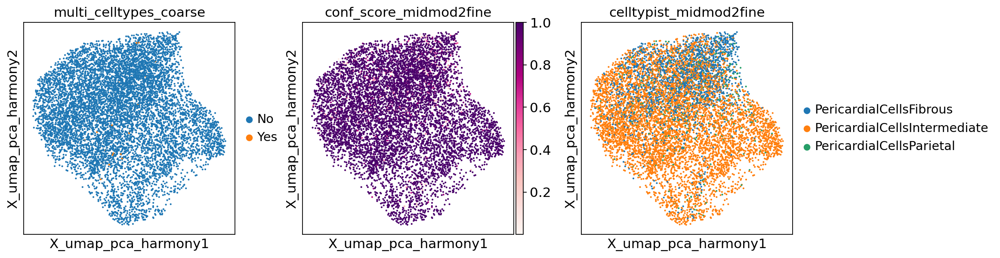

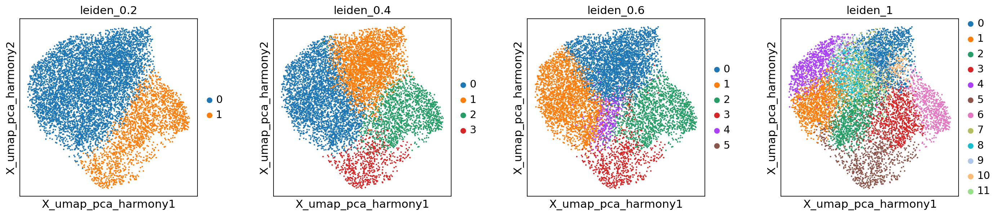

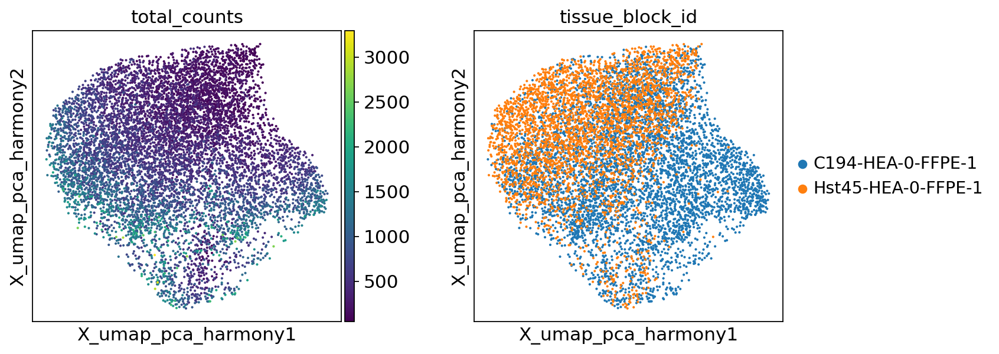


##### MuralCells #####
(10986, 4771)
number of hvgs: 1020


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:22:38,155 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:22:40,321 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:22:40,360 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:22:41,646 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:22:42,901 - harmonypy - INFO - Converged after 2 iterations


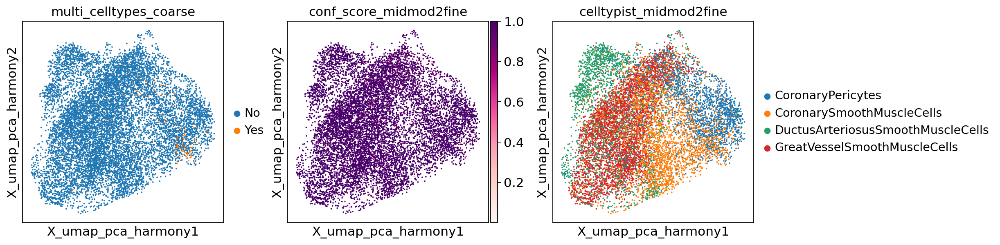

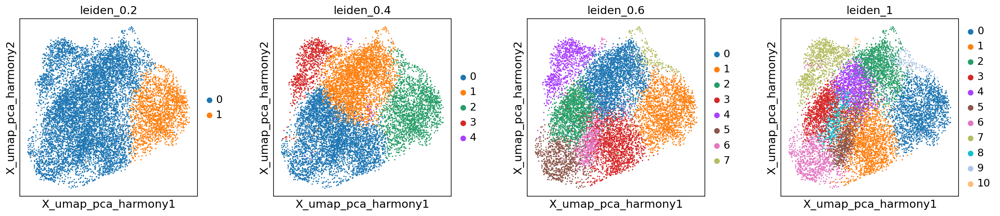

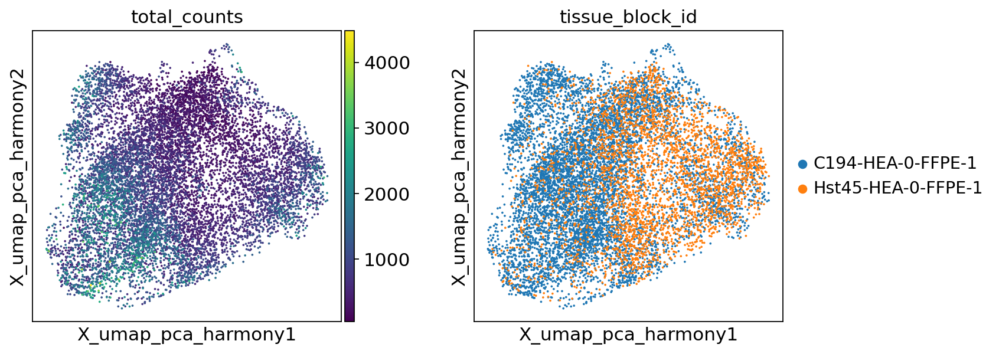


##### Glia #####
(6976, 4699)
number of hvgs: 981


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:23:02,139 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:23:04,310 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:23:04,336 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:23:05,373 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:23:06,435 - harmonypy - INFO - Converged after 2 iterations


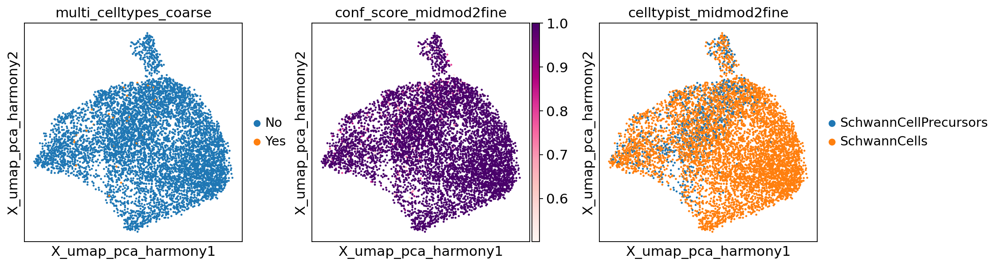

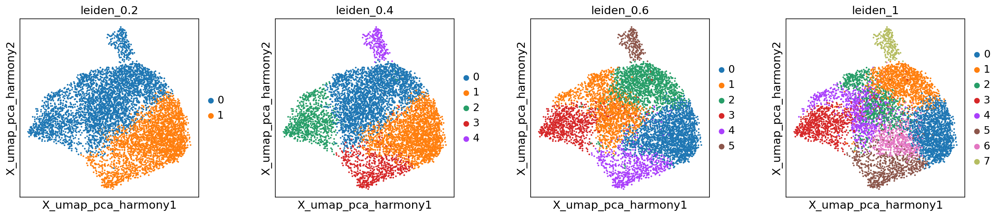

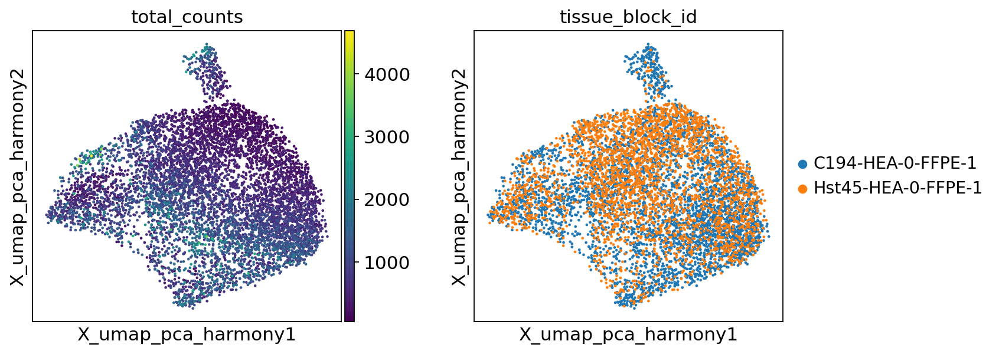

/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:23:24,923 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...



##### Neurons #####
(1992, 4270)
number of hvgs: 1142


2025-05-30 00:23:26,337 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:23:26,343 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:23:26,479 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:23:26,614 - harmonypy - INFO - Converged after 2 iterations


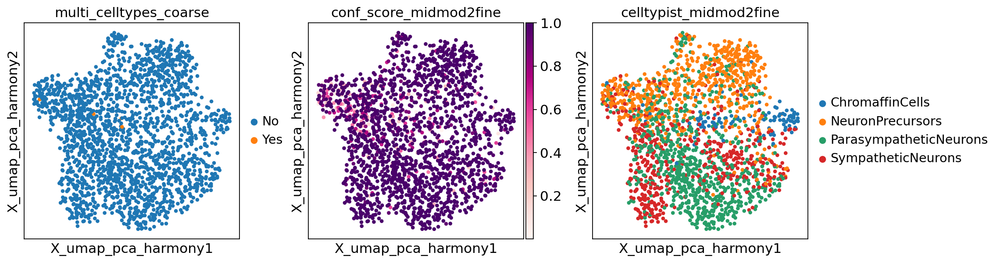

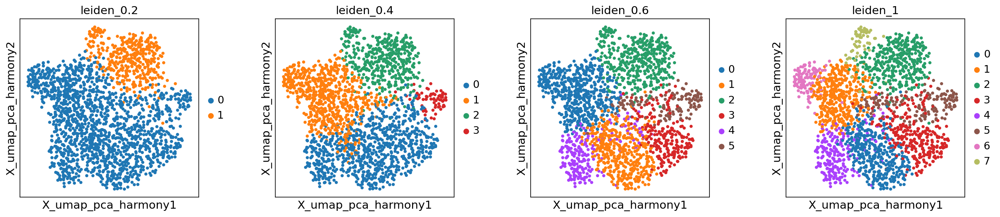

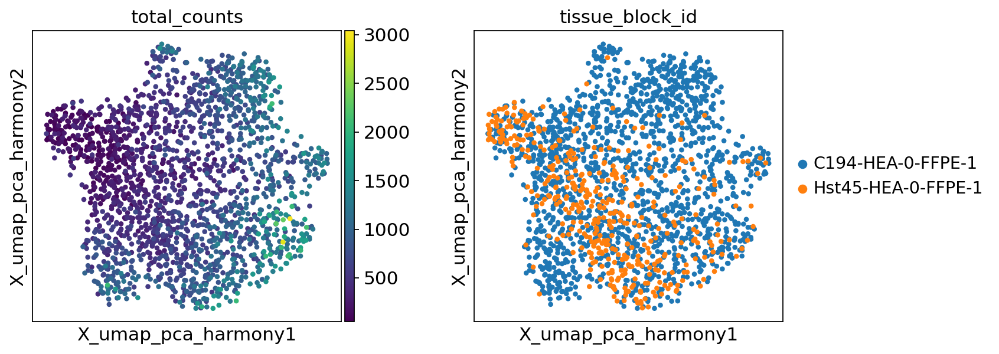


##### VentricularCardiomyocytes #####


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number


(188122, 5001)
number of hvgs: 607


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:23:39,519 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:24:01,431 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:24:02,379 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:24:53,142 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:25:46,356 - harmonypy - INFO - Converged after 2 iterations


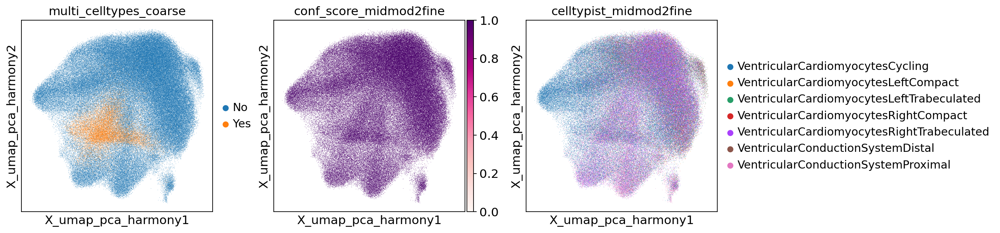

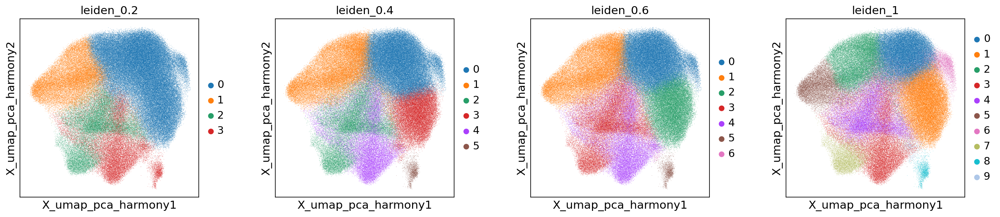

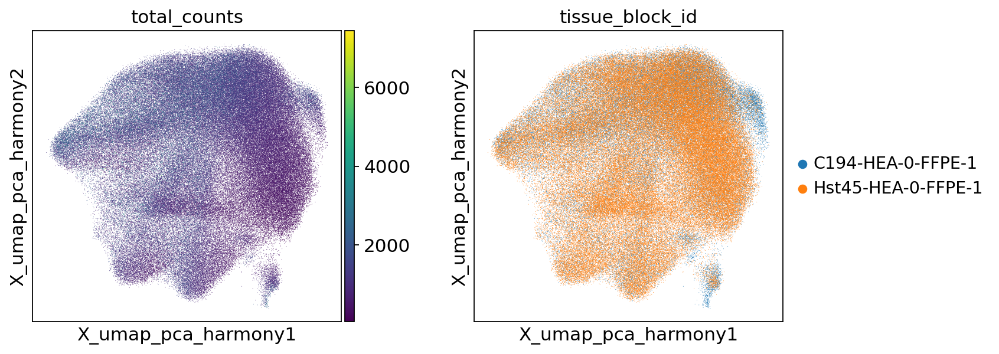


##### MyeloidCells #####
(3965, 4505)
number of hvgs: 925


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:32:35,867 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:32:37,357 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:32:37,369 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:32:37,765 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:32:38,171 - harmonypy - INFO - Converged after 2 iterations


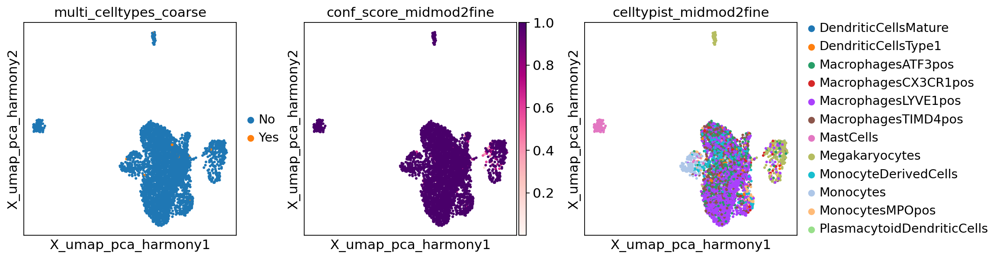

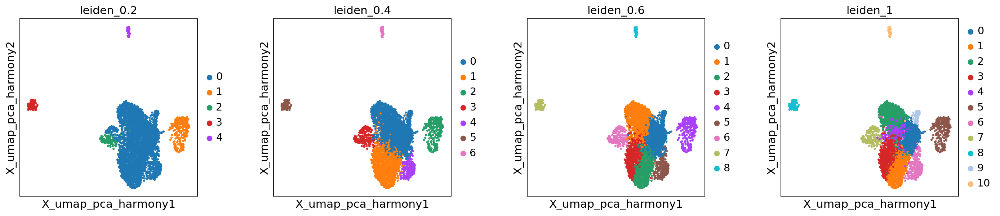

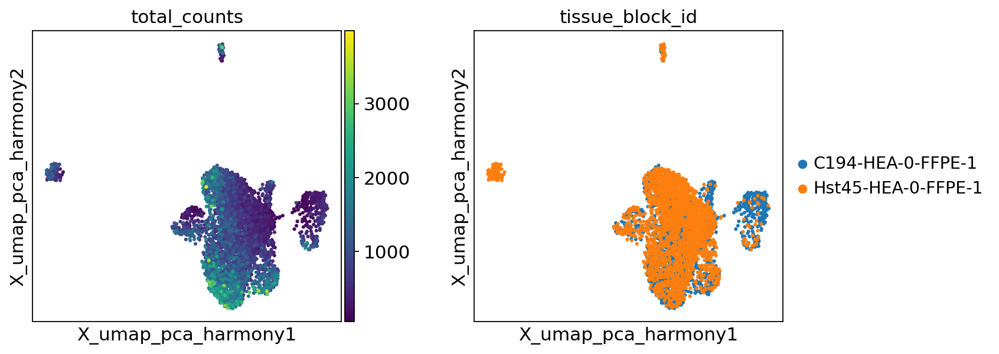


##### LymphoidCells #####
(3116, 4614)
number of hvgs: 919


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:32:48,991 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:32:50,433 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:32:50,444 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:32:50,735 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:32:51,040 - harmonypy - INFO - Converged after 2 iterations


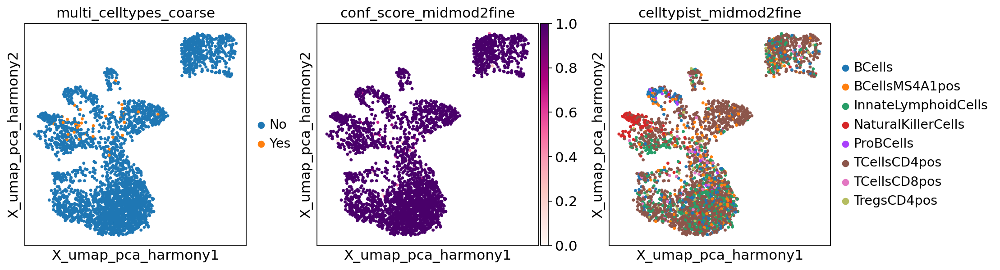

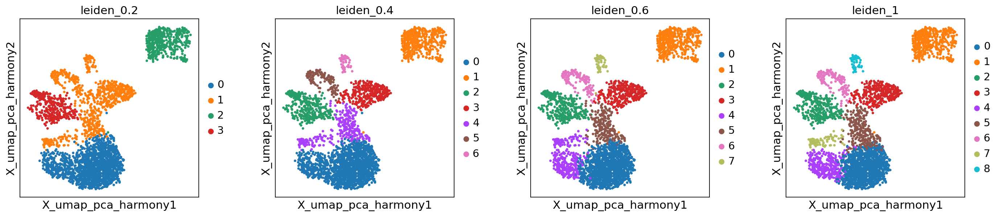

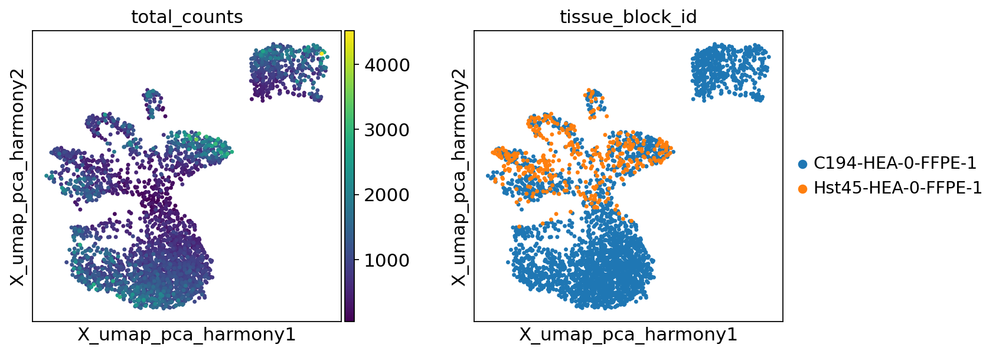


##### BloodVesselEndothelialCells #####
(20055, 4950)


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


number of hvgs: 820


2025-05-30 00:33:00,376 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:33:03,215 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:33:03,256 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:33:05,943 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:33:08,587 - harmonypy - INFO - Converged after 2 iterations


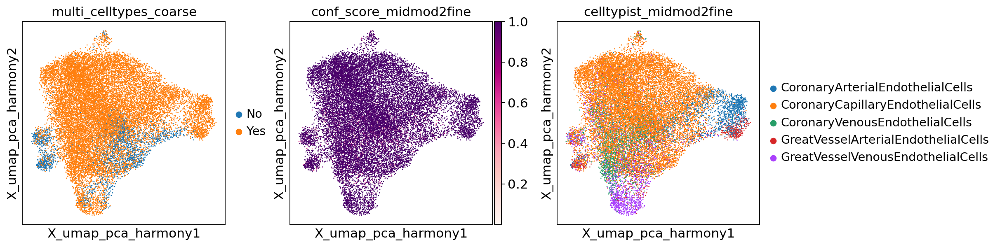

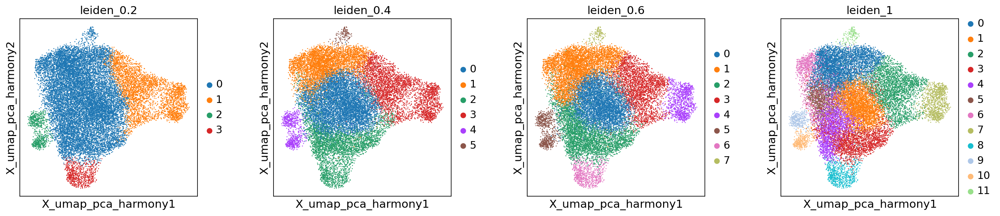

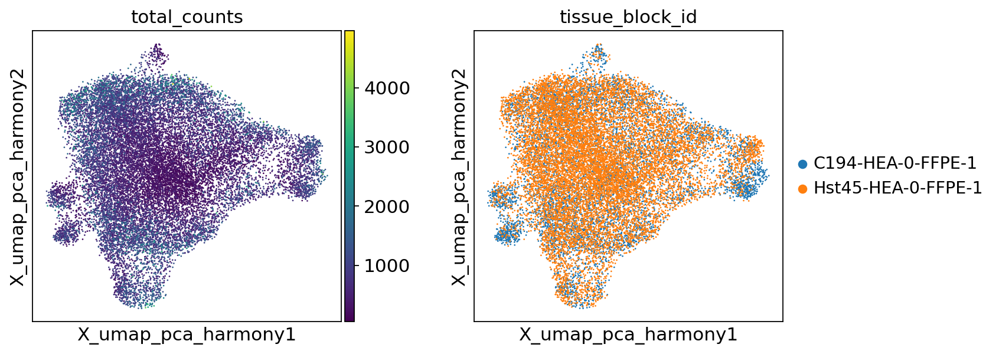


##### AtrialCardiomyocytes #####


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number


(47076, 5000)
number of hvgs: 627


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:33:44,353 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:33:49,775 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:33:49,906 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:33:58,663 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:34:06,411 - harmonypy - INFO - Converged after 2 iterations


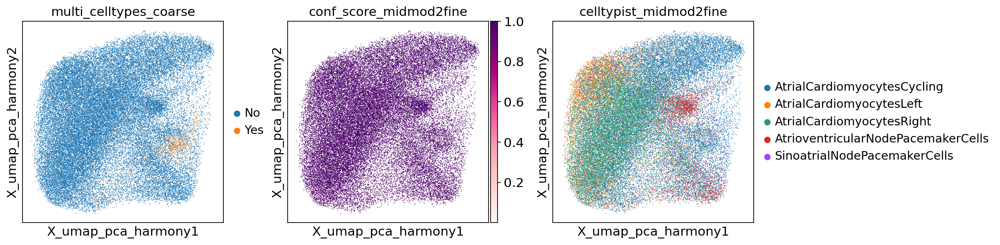

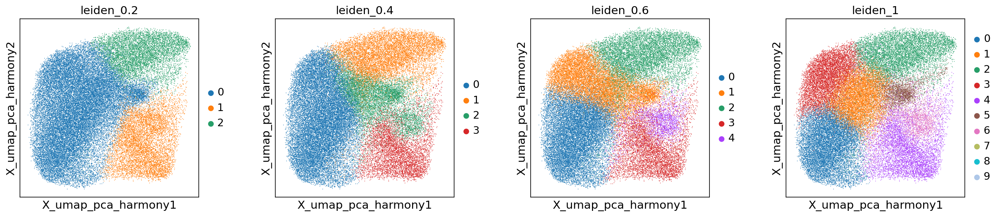

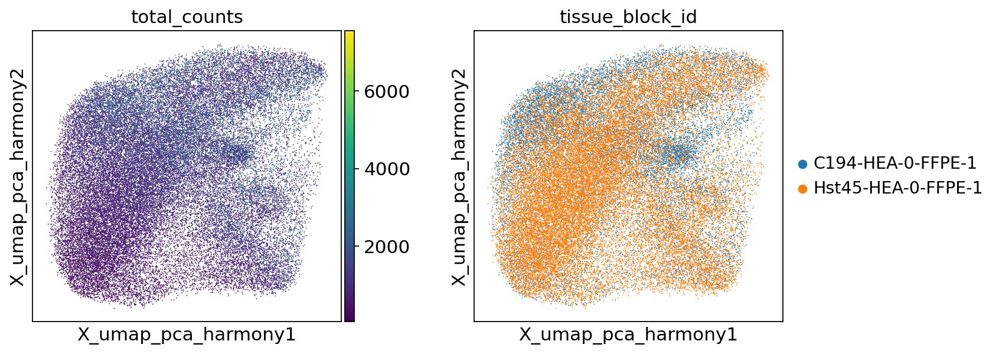


##### EndocardialCells #####
(5202, 4492)
number of hvgs: 945


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:35:28,149 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:35:29,818 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:35:29,833 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:35:30,416 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:35:31,000 - harmonypy - INFO - Converged after 2 iterations


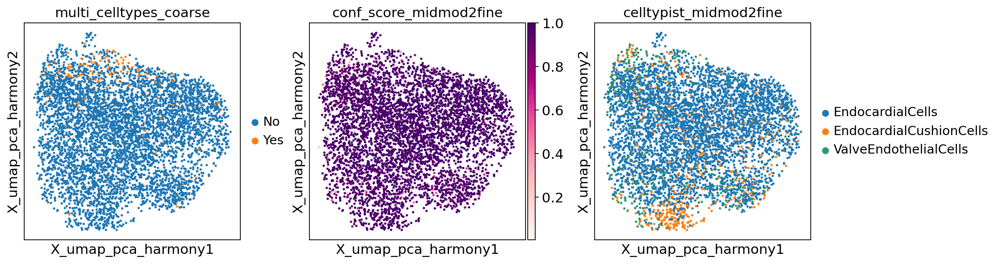

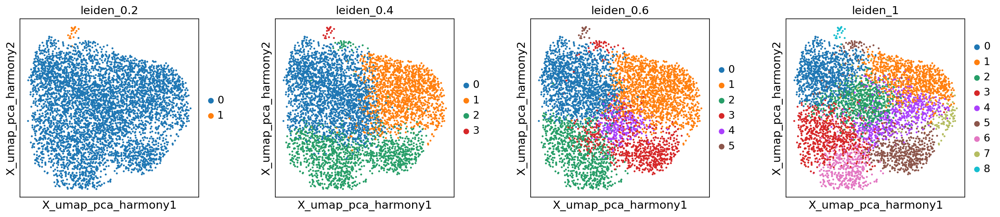

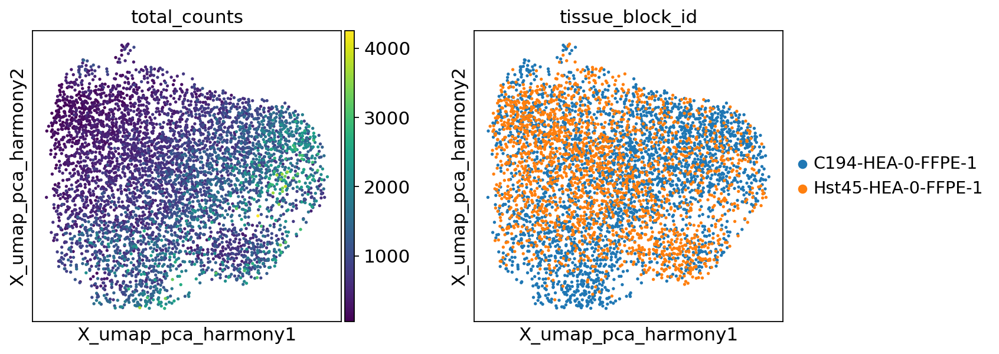


##### LymphaticEndothelialCells #####
(3674, 4576)
number of hvgs: 889


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:35:44,974 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:35:46,515 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:35:46,527 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:35:46,877 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:35:47,224 - harmonypy - INFO - Converged after 2 iterations
/home/kk837/.cond

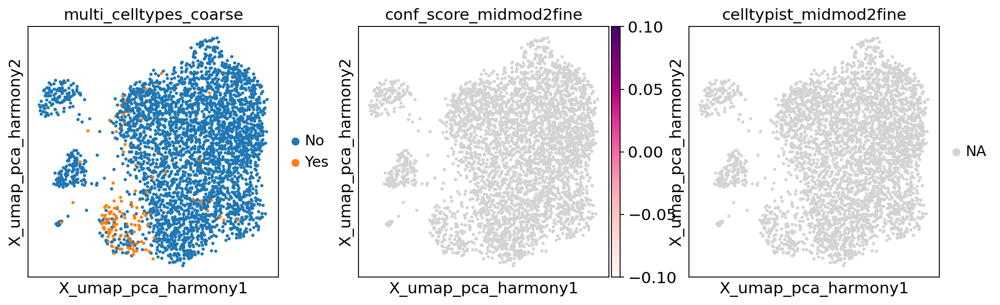

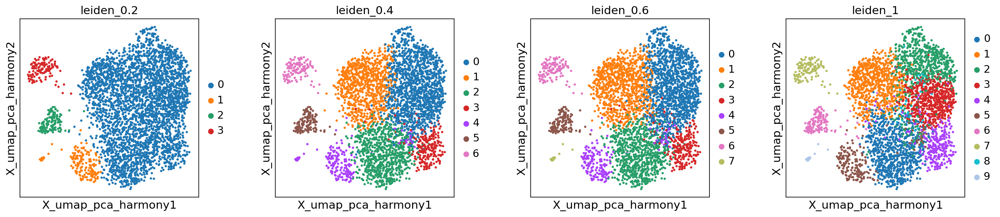

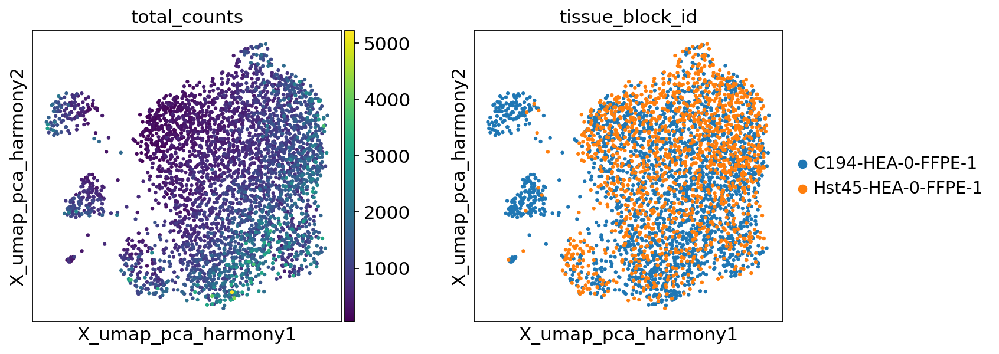


##### EpicardialCells #####
(5206, 4657)
number of hvgs: 1052


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:287: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-05-30 00:35:57,504 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-30 00:35:59,232 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-30 00:35:59,244 - harmonypy - INFO - Iteration 1 of 10
2025-05-30 00:35:59,798 - harmonypy - INFO - Iteration 2 of 10
2025-05-30 00:36:00,348 - harmonypy - INFO - Converged after 2 iterations


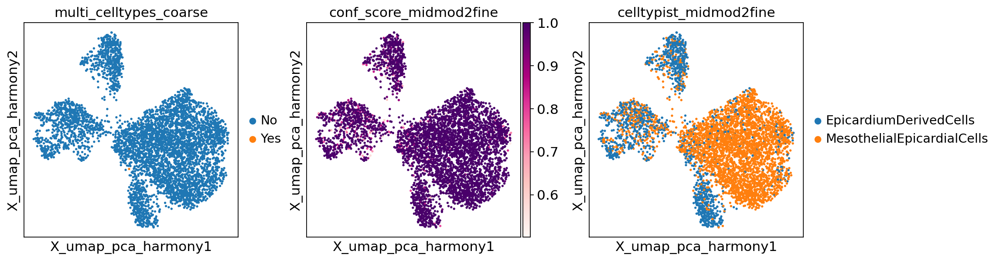

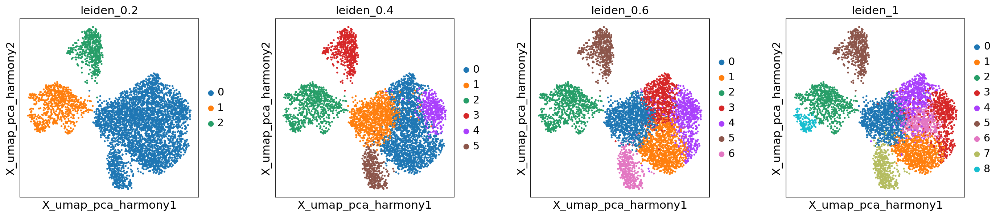

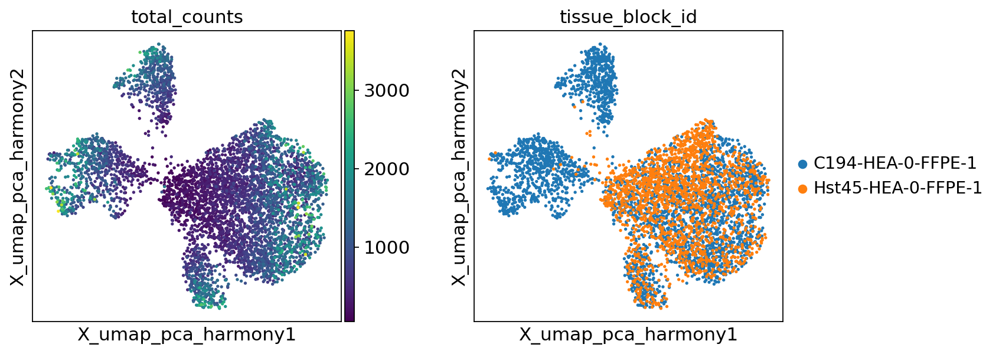


CPU times: user 19min 17s, sys: 21.2 s, total: 19min 39s
Wall time: 16min 21s


In [11]:
%%time
for celltype in adata.obs['celltypist_mid_fin'].unique():
    if celltype == 'unassigned':
        continue
    
    print(f'##### {celltype} #####')
    # subset
    adata_sub = adata[adata.obs['celltypist_mid_fin']==celltype]
    sc.pp.filter_genes(adata_sub, min_cells=3)
    print(adata_sub.shape)
    # HVGs
    sc.pp.highly_variable_genes(adata_sub, flavor='seurat', min_mean=0.0125, max_mean=3, min_disp=0.5)
    print(f'number of hvgs: {sum(adata_sub.var.highly_variable)}')
    # PCA
    sc.tl.pca(adata_sub, use_highly_variable=True)
    # harmony integration
    sce.pp.harmony_integrate(adata_sub, 'tissue_block_id', basis='X_pca', adjusted_basis='X_pca_harmony')
    # create neighbour graph
    latent_space = 'pca_harmony'
    sc.pp.neighbors(adata_sub,n_neighbors=15,use_rep=f"X_{latent_space}",key_added=latent_space)
    # visualisation with umap
    sc.tl.umap(adata_sub,min_dist=0.5,neighbors_key=latent_space)
    adata_sub.obsm[f"X_umap_{latent_space}"]=adata_sub.obsm["X_umap"]
    del adata_sub.obsm["X_umap"]
    sc.pl.embedding(adata_sub, basis=f"X_umap_{latent_space}",
                    color=['multi_celltypes_coarse',"conf_score_midmod2fine","celltypist_midmod2fine",],
                    wspace=0.2,cmap='RdPu',vmax='p100')
    # leiden clustering
    resolutions_list = [0.2,0.4,0.6,1]
    for resolution in resolutions_list:
        sc.tl.leiden(adata_sub,neighbors_key=latent_space,
                     resolution=resolution,key_added=f'leiden_{str(resolution)}',n_iterations=2)
    sc.pl.embedding(adata_sub, basis=f"X_umap_{latent_space}",
                    color=[f'leiden_{str(resolution)}' for resolution in resolutions_list],
                    wspace=0.3)
    # tissue id
    sc.pl.embedding(adata_sub, basis=f"X_umap_{latent_space}",
                    color=['total_counts','tissue_block_id'],
                    wspace=0.3)
    # save
    adata_sub.write(f'{adata_dir}/C194-HEA-0-FFPE-1_Hst45-HEA-0-FFPE-1_concat_5K_{celltype}_lognorm.h5ad')
    print('')